# GG4257 - Urban Analytics
---
## Assignment 2
---

### Lab 6: Geodemographics

Lab 6 served as an introduction to geodemographic modelling. This allows us to analyse populations at the neighbourhood scale. It also introduced the k-means clustering method, which is a way of grouping data into clusters of similar characteristics (working on the assumption that people with similar characteristics group together).

### Contents:

- <a href="#All-packages-needed-to-run-this-code:">Packages</a>
- <a href="#Challenge-1:">Challenge 1</a>

---


### All packages needed to run this code:

In [12]:
import os
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans
from scipy.spatial.distance import cdist, pdist
import numpy as np
import plotly.express as px
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

---

### Challenge 1: 
**1. Define the main goal for the geodemographic classification (marketing, retail and service planning).**

   
I've decided to keep the theme of my previous lab and pick York in England as my city to work through these tasks with. I'm going to focus on sorting populations to find best places/populations to focus charitable efforts.

**2. Look for census data from the selected city for which you would like to generate the geodemographic classification.**

Finding data from Infuse through the UK Data Service (Infuse, 2024)

**3. The census data at the Output Area OA level. Select multiple topics of at least four topics (socio-demographics, economics, health, and so on). Describe your topic selection accordingly based on the goal of your geodemographic classification. For example, if your geodemographics are related to marketing, economic variables might be the appropriate selection.**


To carry out a geodemographic modelling of York, I have selected the following datasets from the England and Wales Census from 2011 (UK Data Service, 2011). The range in topics should allow for an effective geodemographic model of York to be formed, which will subsequently allow us to create klusters to view where would be most effective for new social services to be place or aid schemes to be put into effect. 

The data will be imported from CSV format, and joined to a shapefile of output area boundaries in York to allow for successful mapping of the data. 


| Data | Topic | Description | 
| ------ | --- | --- |
| Age | Demographic | Data regarding age is often seen as one of the main characteristics that should always be included within studies of demographic data. |
| Sex | Demographic | Same as age, sex is often regarded as a core demographic characteristic to be included in all demographic studies. |
| Marital Status | Demographic | This data includes matrial and civil partnership statuses, seen as important here as seperated invidivuals with dependent children may require more help with childcare etc. |
| Household composition | Household | Household composition (like marital status too) might be able to suggest where more support for families is required, by identifying households with fewer adults and more dependents.  |
| Car or Van Availability | Household/Economic | Car or van availability per household can be a useful economic indicator, areas with fewer vehicles owned may need better supported public transport for residents. |
| Tenure | Household/Economic | Allows us to see the distribution of homeownership/renters. Measured here by household rather than by individual. An area with increased rates of renting or areas of social housing might require more access to social services and financial aid. |
| Number of Persons Per Bedroom | Household/Economic | Describes the average number of people per bedroom in a household. Allows us to view the distribution of households that may have over overcrowding issues |
| Economic Activity | Economics | Economically inactive individuals (or economically active but unemployed individuals) may require more support from social services. |
| General Health | Health | A measure of self-rated health. Those with lower self-rated health could required more support with day to day activities. |
| Long Term Health Issues | Health | This measure provides a count for how many people have long-term health issues that provide limitations for their day to day activities. As with the previous measure of health, knowing which areas have more people with health problems can allow aid and services to concentrate within those areas. |
| Highest Level of Qualification Achieved | Education | Places with higher populations of individuals with no formal qualifications may need more support or training to secure a job. |
| Deprivation Classification of Household | Combination | This data shows how many households fall into multiple classifications of deprivation, including measures of employment, education, health, and housing. This is a good alrounder measure, as households that fall into more classifications of deprivation might require more support from social and charitable services |

In [ ]:
# starting with reading in all the csv files

# defining the directory where all the csv files are and putting all the files in a list
#york_csv_directory = "data/lab6/"
#york_csv_files = [file for file in os.listdir(york_csv_directory) if file.endswith(".csv")]

# initiallising an empty dataframe
#york_merged_data = pd.DataFrame()

# for loop to go through all csv files and add them into our dataframe
#for csv_file in york_csv_files:
#    york_csv_path = os.path.join(york_csv_directory, csv_file) # adapts the path for each file as we loop through
#    york_df_csv = pd.read_csv(york_csv_path, low_memory=False) # reads the file
#    york_merged_data = pd.concat([york_merged_data, york_df_csv], axis=1) # adds the file to our dataframe

# saving our new CSV file.
#york_merged_data.to_csv("data/lab6/results/york_merged_census_data.csv", index=False)

# hashtagged out because we've done this now so don't need to do it again!!

In [2]:
# reading in our merged dataframe now
merged_csv_path = "data/lab6/results/york_merged_census_data.csv"
york_merged = pd.read_csv(merged_csv_path, low_memory=False)

In [3]:
# next reading the shapefile into a geodataframe
shapefile_york = "data/lab6/York_boundary_data/england_oac_2011.shp"
gdf_york = gpd.read_file(shapefile_york) #reading the shapefile into a geodataframe

In [4]:
merged_gdf_york = gdf_york.merge(york_merged, left_on='code', right_on='oa_code', how='left')

In [5]:
# saved as a shapefile - might have some issues with longer variables names being renamed
merged_gdf_york.to_file('data/lab6/results/york_census_data.shp', index=False)

/var/folders/ws/fppdvhv55qjd63f1b6wky7kr0000gn/T/ipykernel_88684/179740336.py:2: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  merged_gdf_york.to_file('data/lab6/results/york_census_data.shp', index=False)


**4. Identify the variables that will be crucial for effectively segmenting neighbourhoods. Evaluate how this choice may impact the classification results, including a DEA analysis.**


In [6]:
# making a list of all the variables we have to choose from - there's a lot of them!!
list(merged_gdf_york.columns)

['code',
 'label',
 'name',
 'oac_super_',
 'oac_group',
 'oac_sub_gr',
 'oac_supe_1',
 'oac_group_',
 'oac_sub__1',
 'geometry',
 'oa_code',
 'Car or van: Total vehicles',
 'No cars or vans in household',
 '1 car or van in household',
 '2 cars or vans in household',
 '3 cars or vans in household',
 '4 or more cars or vans in household',
 'oa_code.1',
 'Long-term health problem or disability: Total',
 'Long-term health problem or disability: Day-to-day activities limited a lot',
 'Long-term health problem or disability: Day-to-day activities limited a little',
 'Long-term health problem or disability: Day-to-day activities not limited',
 'Long-term health problem or disability: Day-to-day activities limited',
 'oa_code.2',
 'total',
 'Age 0 to 4',
 'Age 5 to 7',
 'Age 8 to 9',
 'Age 10 to 14',
 'Age 15',
 'Age 16 to 17',
 'Age 18 to 19',
 'Age 20 to 24',
 'Age 25 to 29',
 'Age 30 to 44',
 'Age 45 to 59',
 'Age 60 to 64',
 'Age 65 to 74',
 'Age 75 to 84',
 'Age 85 to 89',
 'Age 90 and o

In [7]:
merged_gdf_york['No cars or vans in household'].describe()

count    637.000000
mean      34.235479
std       22.505788
min        0.000000
25%       17.000000
50%       29.000000
75%       50.000000
max      137.000000
Name: No cars or vans in household, dtype: float64

In [8]:
merged_gdf_york['Age 30 to 44'].describe()

count    637.000000
mean      60.938776
std       21.976496
min        9.000000
25%       47.000000
50%       59.000000
75%       72.000000
max      196.000000
Name: Age 30 to 44, dtype: float64

In [9]:
merged_gdf_york['Age 90 and over'].describe()

count    637.000000
mean       2.601256
std        3.972927
min        0.000000
25%        0.000000
50%        2.000000
75%        3.000000
max       53.000000
Name: Age 90 and over, dtype: float64

In [ ]:
attributes_to_plot1 = ['No cars or vans in household',
                      'Long-term health problem or disability: Day-to-day activities limited a lot',
                      'Bedrooms: Over 1.5 persons per bedroom',
                      'Economically active: Unemployed',
                      'Males',
                      'Females']

plt.figure(figsize=(12, 8))

for i, attribute in enumerate(attributes_to_plot1, 1):
    plt.subplot(3, 2, i)
    sns.histplot(merged_gdf_york[attribute].astype(str), kde=True)
    plt.title(attribute)

plt.tight_layout()
plt.show()

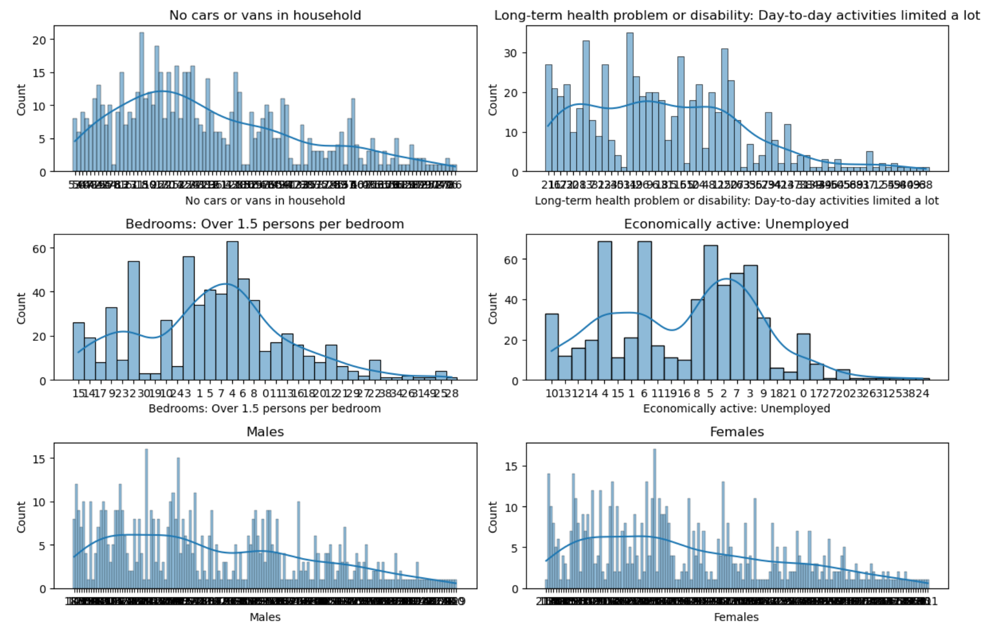

In [ ]:
attributes_to_plot2 = ['Marital status: Separated (but still legally married or still legally in a same-sex civil partnership)',
                      'Marital status: Divorced or formerly in a same-sex civil partnership which is now legally dissolved',
                      'Marital status: Widowed or surviving partner from a same-sex civil partnership',
                      'No qualifications',
                      'Deprivation: Household is deprived in 3 dimensions or more',
                      'One family only: Married or same-sex civil partnership couple: Dependent children'
                      ]

plt.figure(figsize=(12, 8))

for i, attribute in enumerate(attributes_to_plot2, 1):
    plt.subplot(3, 2, i)
    sns.histplot(merged_gdf_york[attribute].astype(str), kde=True)
    plt.title(attribute)

plt.tight_layout()
plt.show()

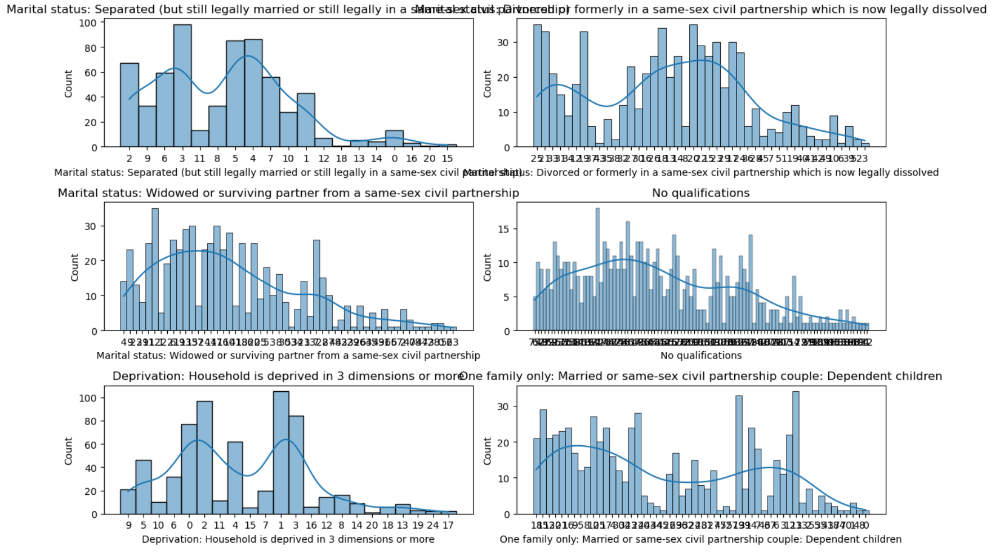

In [ ]:
attributes_to_plot3 = ['One family only: Cohabiting couple: Dependent children',
                       'One family only: Lone parent: Dependent children',
                       'Other households: With dependent children',
                       'General health: Bad or very bad health'
                      ]

plt.figure(figsize=(8, 8))

for i, attribute in enumerate(attributes_to_plot3, 1):
    plt.subplot(3, 2, i)
    sns.histplot(merged_gdf_york[attribute].astype(str), kde=True)
    plt.title(attribute)

plt.tight_layout()
plt.show()

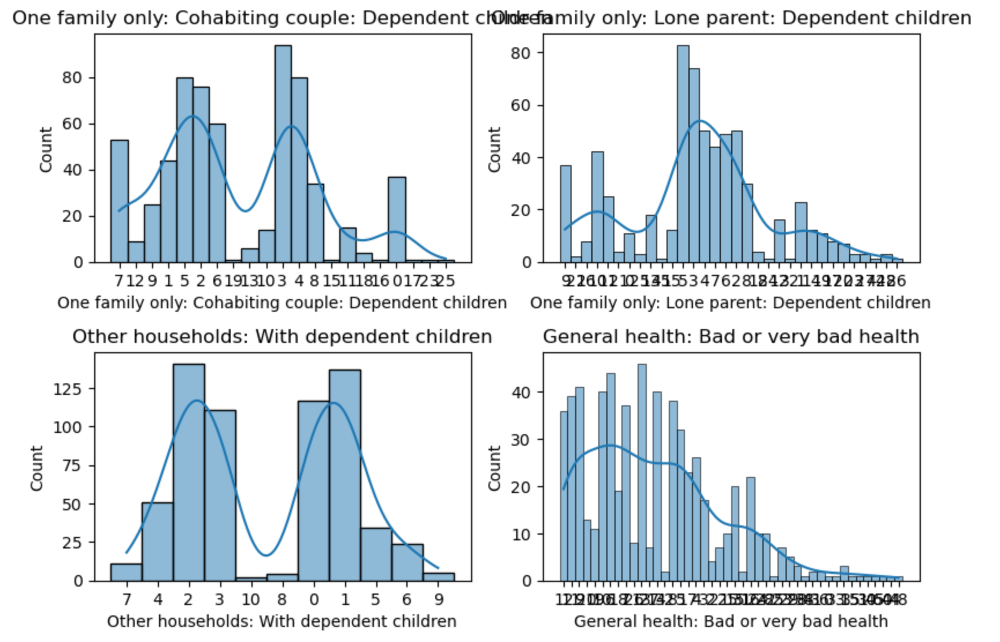

**5. Prepare, adjust or clean the dataset addressing any missing values or outliers that could distort the clustering results.**

In [19]:
# checking for the presence of NAs 
merged_gdf_york.isna().sum()
# looks like the only column with NAs is the 'name' but we will drop that one when we subset later!

code                                        0
label                                       0
name                                      637
oac_super_                                  0
oac_group                                   0
                                         ... 
General health : Very good health           0
General health : Good health                0
General health : Fair health                0
General health : Bad health                 0
General health: Bad or very bad health      0
Length: 126, dtype: int64

**6. Include standardisation between areas and variables. Make an appropriate analysis and adjust the variable selection accordingly for any multicollinearity.**

To standardise variables between areas, we need to turn all of our raw count data into percentages that can be compared and analysed. 


In [20]:
def calculate_percentages(dataframe, total_columns, value_columns):

    result_df = pd.DataFrame()

    for total_col, value_col in zip(total_columns, value_columns):
        percentage_col_name = f"{value_col}_percentage"

        if total_col not in dataframe.columns:
            raise ValueError(f"Total column '{total_col}' not found in the DataFrame.")
        # The data have several empty values, so you need to process them, forcing them to be a numeric or NaN value
        dataframe[value_col] = pd.to_numeric(dataframe[value_col], errors='coerce')
        dataframe[total_col] = pd.to_numeric(dataframe[total_col], errors='coerce')
        
        result_df[percentage_col_name] = (dataframe[value_col] / dataframe[total_col]) * 100

    return result_df

# List of the corresponding totals.
total_cols = ['Car or van: Total vehicles',
              'Long-term health problem or disability: Total',
              'Persons per bedroom: Total',
              'Economically active: Total',
              'Sex Total', 'Sex Total',
              'Marital status: Total aged 16 and over',
              'Marital status: Total aged 16 and over',
              'Marital status: Total aged 16 and over',
              'Qualification: Total age 16 and over',
              'Deprivation: Total',
              'Total households',
              'Total households',
              'Total households',
              'Total households',
              'General health: Total',
              'total', 'total'
              
             ]

# List of the corresponding values. 
value_cols = ['No cars or vans in household',
              'Long-term health problem or disability: Day-to-day activities limited a lot',
              'Bedrooms: Over 1.5 persons per bedroom',
              'Economically active: Unemployed',
              'Males', 'Females',
              'Marital status: Separated (but still legally married or still legally in a same-sex civil partnership)',
              'Marital status: Divorced or formerly in a same-sex civil partnership which is now legally dissolved',
              'Marital status: Widowed or surviving partner from a same-sex civil partnership',
              'No qualifications',
              'Deprivation: Household is deprived in 3 dimensions or more',
              'One family only: Married or same-sex civil partnership couple: Dependent children',
              'One family only: Cohabiting couple: Dependent children',
              'One family only: Lone parent: Dependent children',
              'Other households: With dependent children',
              'General health: Bad or very bad health',
              'Age 30 to 44', 'Age 90 and over'
              
             ]


# Later we migth need to rename those columns., for now is ok...
result_dataframe = calculate_percentages(merged_gdf_york, total_cols, value_cols)


In [21]:
result_dataframe.shape # checking the shape, looks good

(637, 18)

In [22]:
result_dataframe.head() # checking the results - again all looking okay at the moment

,No cars or vans in household_percentage,Long-term health problem or disability: Day-to-day activities limited a lot_percentage,Bedrooms: Over 1.5 persons per bedroom_percentage,Economically active: Unemployed_percentage,Males_percentage,Females_percentage,Marital status: Separated (but still legally married or still legally in a same-sex civil partnership)_percentage,Marital status: Divorced or formerly in a same-sex civil partnership which is now legally dissolved_percentage,Marital status: Widowed or surviving partner from a same-sex civil partnership_percentage,No qualifications_percentage,Deprivation: Household is deprived in 3 dimensions or more_percentage,One family only: Married or same-sex civil partnership couple: Dependent children_percentage,One family only: Cohabiting couple: Dependent children_percentage,One family only: Lone parent: Dependent children_percentage,Other households: With dependent children_percentage,General health: Bad or very bad health_percentage,Age 30 to 44_percentage,Age 90 and over_percentage
0,43.089431,5.289673,12.195122,5.524862,46.095718,53.904282,0.625000,7.812500,1.250000,23.437500,7.317073,14.634146,5.691057,7.317073,5.691057,3.022670,14.861461,0.251889
1,41.322314,5.263158,11.570248,9.352518,47.039474,52.960526,4.035874,9.417040,4.035874,27.802691,4.132231,12.396694,9.917355,18.181818,3.305785,3.618421,20.065789,0.328947
2,32.786885,6.589147,11.475410,7.500000,49.224806,50.775194,4.411765,16.176471,1.960784,21.078431,7.377049,10.655738,5.737705,13.114754,1.639344,3.488372,25.968992,0.000000
3,35.338346,6.940063,12.781955,8.235294,50.473186,49.526814,2.400000,12.400000,9.200000,30.800000,7.518797,15.037594,6.766917,7.518797,2.255639,6.309148,23.659306,0.946372
4,33.333333,8.310249,6.250000,2.061856,45.152355,54.847645,3.125000,11.805556,10.069444,30.902778,4.166667,14.583333,4.861111,7.638889,6.944444,5.540166,20.775623,0.554017


In [23]:
# join it to the merged dataframe!
concatenated_df = pd.concat([merged_gdf_york, result_dataframe], axis=1, ignore_index=False)
concatenated_df.head()

,code,label,name,oac_super_,oac_group,oac_sub_gr,oac_supe_1,oac_group_,oac_sub__1,geometry,...,Marital status: Widowed or surviving partner from a same-sex civil partnership_percentage,No qualifications_percentage,Deprivation: Household is deprived in 3 dimensions or more_percentage,One family only: Married or same-sex civil partnership couple: Dependent children_percentage,One family only: Cohabiting couple: Dependent children_percentage,One family only: Lone parent: Dependent children_percentage,Other households: With dependent children_percentage,General health: Bad or very bad health_percentage,Age 30 to 44_percentage,Age 90 and over_percentage
0,E00067637,E06000014E02002786E01013398E00067637,NaN,8,8d,8d2,Hard-Pressed Living,Migration and Churn,Hard-Pressed Ethnic Mix,"POLYGON ((462922.418 451627.087, 462923.413 45...",...,1.250000,23.437500,7.317073,14.634146,5.691057,7.317073,5.691057,3.022670,14.861461,0.251889
1,E00067657,E06000014E02002786E01013399E00067657,NaN,8,8d,8d2,Hard-Pressed Living,Migration and Churn,Hard-Pressed Ethnic Mix,"POLYGON ((462138.199 451643.374, 462150.138 45...",...,4.035874,27.802691,4.132231,12.396694,9.917355,18.181818,3.305785,3.618421,20.065789,0.328947
2,E00067859,E06000014E02002789E01013448E00067859,NaN,8,8d,8d2,Hard-Pressed Living,Migration and Churn,Hard-Pressed Ethnic Mix,"POLYGON ((457422.000 449898.000, 457424.784 44...",...,1.960784,21.078431,7.377049,10.655738,5.737705,13.114754,1.639344,3.488372,25.968992,0.000000
3,E00067868,E06000014E02002789E01013446E00067868,NaN,8,8d,8d2,Hard-Pressed Living,Migration and Churn,Hard-Pressed Ethnic Mix,"POLYGON ((456586.580 450678.969, 456586.981 45...",...,9.200000,30.800000,7.518797,15.037594,6.766917,7.518797,2.255639,6.309148,23.659306,0.946372
4,E00067873,E06000014E02002789E01013446E00067873,NaN,8,8d,8d2,Hard-Pressed Living,Migration and Churn,Hard-Pressed Ethnic Mix,"POLYGON ((456712.569 450655.748, 456709.691 45...",...,10.069444,30.902778,4.166667,14.583333,4.861111,7.638889,6.944444,5.540166,20.775623,0.554017


In [24]:
concatenated_df.shape # checking the shape of the new concatenated dataframe

(637, 144)

In [25]:
list(concatenated_df.columns) # checking the columns - our % columns are now there and looking lovely

['code',
 'label',
 'name',
 'oac_super_',
 'oac_group',
 'oac_sub_gr',
 'oac_supe_1',
 'oac_group_',
 'oac_sub__1',
 'geometry',
 'oa_code',
 'Car or van: Total vehicles',
 'No cars or vans in household',
 '1 car or van in household',
 '2 cars or vans in household',
 '3 cars or vans in household',
 '4 or more cars or vans in household',
 'oa_code.1',
 'Long-term health problem or disability: Total',
 'Long-term health problem or disability: Day-to-day activities limited a lot',
 'Long-term health problem or disability: Day-to-day activities limited a little',
 'Long-term health problem or disability: Day-to-day activities not limited',
 'Long-term health problem or disability: Day-to-day activities limited',
 'oa_code.2',
 'total',
 'Age 0 to 4',
 'Age 5 to 7',
 'Age 8 to 9',
 'Age 10 to 14',
 'Age 15',
 'Age 16 to 17',
 'Age 18 to 19',
 'Age 20 to 24',
 'Age 25 to 29',
 'Age 30 to 44',
 'Age 45 to 59',
 'Age 60 to 64',
 'Age 65 to 74',
 'Age 75 to 84',
 'Age 85 to 89',
 'Age 90 and o

In [26]:
# now that's all done, we'll subset the data set to only include the columns we need

keep_columns = ['oa_code',
                'geometry',
                'No cars or vans in household_percentage',
                'Long-term health problem or disability: Day-to-day activities limited a lot_percentage',
                'Bedrooms: Over 1.5 persons per bedroom_percentage',
                'Economically active: Unemployed_percentage',
                'Males_percentage',
                'Females_percentage',
                'Marital status: Separated (but still legally married or still legally in a same-sex civil partnership)_percentage',
                'Marital status: Divorced or formerly in a same-sex civil partnership which is now legally dissolved_percentage',
                'Marital status: Widowed or surviving partner from a same-sex civil partnership_percentage',
                'No qualifications_percentage',
                'Deprivation: Household is deprived in 3 dimensions or more_percentage',
                'One family only: Married or same-sex civil partnership couple: Dependent children_percentage',
                'One family only: Cohabiting couple: Dependent children_percentage',
                'One family only: Lone parent: Dependent children_percentage',
                'Other households: With dependent children_percentage',
                'General health: Bad or very bad health_percentage',
                'Age 30 to 44_percentage',
                'Age 90 and over_percentage'
                ]

york_census_data = concatenated_df[keep_columns]

In [27]:
york_census_data.head()

,oa_code,geometry,No cars or vans in household_percentage,Long-term health problem or disability: Day-to-day activities limited a lot_percentage,Bedrooms: Over 1.5 persons per bedroom_percentage,Economically active: Unemployed_percentage,Males_percentage,Females_percentage,Marital status: Separated (but still legally married or still legally in a same-sex civil partnership)_percentage,Marital status: Divorced or formerly in a same-sex civil partnership which is now legally dissolved_percentage,Marital status: Widowed or surviving partner from a same-sex civil partnership_percentage,No qualifications_percentage,Deprivation: Household is deprived in 3 dimensions or more_percentage,One family only: Married or same-sex civil partnership couple: Dependent children_percentage,One family only: Cohabiting couple: Dependent children_percentage,One family only: Lone parent: Dependent children_percentage,Other households: With dependent children_percentage,General health: Bad or very bad health_percentage,Age 30 to 44_percentage,Age 90 and over_percentage
0,E00067637,"POLYGON ((462922.418 451627.087, 462923.413 45...",43.089431,5.289673,12.195122,5.524862,46.095718,53.904282,0.625000,7.812500,1.250000,23.437500,7.317073,14.634146,5.691057,7.317073,5.691057,3.022670,14.861461,0.251889
1,E00067657,"POLYGON ((462138.199 451643.374, 462150.138 45...",41.322314,5.263158,11.570248,9.352518,47.039474,52.960526,4.035874,9.417040,4.035874,27.802691,4.132231,12.396694,9.917355,18.181818,3.305785,3.618421,20.065789,0.328947
2,E00067859,"POLYGON ((457422.000 449898.000, 457424.784 44...",32.786885,6.589147,11.475410,7.500000,49.224806,50.775194,4.411765,16.176471,1.960784,21.078431,7.377049,10.655738,5.737705,13.114754,1.639344,3.488372,25.968992,0.000000
3,E00067868,"POLYGON ((456586.580 450678.969, 456586.981 45...",35.338346,6.940063,12.781955,8.235294,50.473186,49.526814,2.400000,12.400000,9.200000,30.800000,7.518797,15.037594,6.766917,7.518797,2.255639,6.309148,23.659306,0.946372
4,E00067873,"POLYGON ((456712.569 450655.748, 456709.691 45...",33.333333,8.310249,6.250000,2.061856,45.152355,54.847645,3.125000,11.805556,10.069444,30.902778,4.166667,14.583333,4.861111,7.638889,6.944444,5.540166,20.775623,0.554017


In [28]:
# renaming columns for easy data manipulation
rename_columns = { #defining a dictionary with columns and corresponding new names
                'No cars or vans in household_percentage': 'noVehicle',
                'Long-term health problem or disability: Day-to-day activities limited a lot_percentage': 'disaLimit',
                'Bedrooms: Over 1.5 persons per bedroom_percentage': 'overBedroom',
                'Economically active: Unemployed_percentage': 'unemployed',
                'Males_percentage':'males',
                'Females_percentage':'females',
                'Marital status: Separated (but still legally married or still legally in a same-sex civil partnership)_percentage': 'separated',
                'Marital status: Divorced or formerly in a same-sex civil partnership which is now legally dissolved_percentage': 'divorced',
                'Marital status: Widowed or surviving partner from a same-sex civil partnership_percentage': 'widowed',
                'No qualifications_percentage':'noQual',
                'Deprivation: Household is deprived in 3 dimensions or more_percentage':'deprived3dim',
                'One family only: Married or same-sex civil partnership couple: Dependent children_percentage':'marriedDepend',
                'One family only: Cohabiting couple: Dependent children_percentage':'cohabitDepend',
                'One family only: Lone parent: Dependent children_percentage': 'singleDepend',
                'Other households: With dependent children_percentage': 'otherDepend',
                'General health: Bad or very bad health_percentage':'badHealth',
                'Age 30 to 44_percentage':'age30to44',
                'Age 90 and over_percentage': 'ageover90'
                 }

# this line uses the dictionary we've just defined to rename columns
york_census_data = york_census_data.rename(columns=rename_columns)

In [29]:
list(york_census_data.columns) # checking that all the column names have been changed - they have!

['oa_code',
 'geometry',
 'noVehicle',
 'disaLimit',
 'overBedroom',
 'unemployed',
 'males',
 'females',
 'separated',
 'divorced',
 'widowed',
 'noQual',
 'deprived3dim',
 'marriedDepend',
 'cohabitDepend',
 'singleDepend',
 'otherDepend',
 'badHealth',
 'age30to44',
 'ageover90']

Next we need to calculate z-scores to create standardisation between variables!

In [30]:
york_census_data.info() # data types look good so we can calculate z-scores for all float data!

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 637 entries, 0 to 636
Data columns (total 20 columns):
 #   Column         Non-Null Count  Dtype   
---  ------         --------------  -----   
 0   oa_code        637 non-null    object  
 1   geometry       637 non-null    geometry
 2   noVehicle      637 non-null    float64 
 3   disaLimit      637 non-null    float64 
 4   overBedroom    637 non-null    float64 
 5   unemployed     637 non-null    float64 
 6   males          637 non-null    float64 
 7   females        637 non-null    float64 
 8   separated      637 non-null    float64 
 9   divorced       637 non-null    float64 
 10  widowed        637 non-null    float64 
 11  noQual         637 non-null    float64 
 12  deprived3dim   637 non-null    float64 
 13  marriedDepend  637 non-null    float64 
 14  cohabitDepend  637 non-null    float64 
 15  singleDepend   637 non-null    float64 
 16  otherDepend    637 non-null    float64 
 17  badHealth      637 non-null

In [31]:
# calculating z scores and putting them in a seperate dataframe!
numeric_columns = york_census_data.select_dtypes(include='float64')
york_z_scores = (numeric_columns - numeric_columns.mean()) / numeric_columns.std(ddof=0)
york_z_scores.head()

,noVehicle,disaLimit,overBedroom,unemployed,males,females,separated,divorced,widowed,noQual,deprived3dim,marriedDepend,cohabitDepend,singleDepend,otherDepend,badHealth,age30to44,ageover90
0,1.097448,-0.368664,1.113309,0.328331,-0.745631,0.745631,-1.155180,-0.305331,-1.258141,0.493902,1.261247,0.035995,0.787427,0.367343,2.627069,-0.461516,-0.872267,-0.456890
1,0.985219,-0.374755,0.989181,1.493089,-0.467768,0.467768,1.594422,0.144767,-0.652068,0.962882,0.272256,-0.251726,2.473778,2.992954,1.041439,-0.253166,0.024159,-0.401654
2,0.443136,-0.070151,0.970341,0.929367,0.175642,-0.175642,1.897438,2.040887,-1.103508,0.240452,1.279871,-0.475601,0.806040,1.768430,-0.066342,-0.298648,1.040963,-0.637449
3,0.605178,0.010461,1.229882,1.153117,0.543193,-0.543193,0.275698,0.981531,0.471399,1.284903,1.323888,0.087876,1.216710,0.416093,0.343345,0.687849,0.643128,0.040926
4,0.477840,0.325218,-0.067667,-0.725464,-1.023378,1.023378,0.860141,0.814781,0.660549,1.295945,0.282949,0.029461,0.456267,0.445114,3.460269,0.418916,0.146425,-0.240321


Next we need to measure for association between variables, and remove variables that are colinear as these will reveal the same trends. We use pearsons coefficient to do this. We calculate pearsons coefficient and significance values for every pair of variables, to see if the are highly correlated or not

In [32]:
corr = york_z_scores.corr()
corr.style.background_gradient(cmap='coolwarm')

,noVehicle,disaLimit,overBedroom,unemployed,males,females,separated,divorced,widowed,noQual,deprived3dim,marriedDepend,cohabitDepend,singleDepend,otherDepend,badHealth,age30to44,ageover90
noVehicle,1.000000,0.327194,0.701113,0.602444,0.053649,-0.053649,0.316110,0.438564,0.038759,0.330560,0.712331,-0.691943,0.116669,0.347141,0.064418,0.464226,0.078560,0.075736
disaLimit,0.327194,1.000000,0.105926,0.266195,-0.291467,0.291467,0.085095,0.374628,0.753563,0.697201,0.414254,-0.312696,-0.054044,0.046512,-0.049199,0.875554,-0.310216,0.663834
overBedroom,0.701113,0.105926,1.000000,0.582658,0.181342,-0.181342,0.300347,0.385286,-0.192116,0.213727,0.620930,-0.377975,0.306161,0.458175,0.214983,0.254857,0.200139,-0.094358
unemployed,0.602444,0.266195,0.582658,1.000000,0.032894,-0.032894,0.322925,0.433692,-0.009357,0.431757,0.689289,-0.295188,0.351115,0.542203,0.241959,0.394923,0.112552,0.030303
males,0.053649,-0.291467,0.181342,0.032894,1.000000,-1.000000,0.035141,-0.127463,-0.417017,-0.257858,0.072022,-0.007578,-0.037837,-0.063209,-0.011039,-0.208747,0.186466,-0.319727
females,-0.053649,0.291467,-0.181342,-0.032894,-1.000000,1.000000,-0.035141,0.127463,0.417017,0.257858,-0.072022,0.007578,0.037837,0.063209,0.011039,0.208747,-0.186466,0.319727
separated,0.316110,0.085095,0.300347,0.322925,0.035141,-0.035141,1.000000,0.433243,-0.087502,0.194378,0.322901,-0.210241,0.282714,0.436310,0.115597,0.194163,0.377050,-0.086978
divorced,0.438564,0.374628,0.385286,0.433692,-0.127463,0.127463,0.433243,1.000000,0.135155,0.461821,0.536044,-0.342173,0.280216,0.395863,-0.000403,0.462311,0.249680,0.082971
widowed,0.038759,0.753563,-0.192116,-0.009357,-0.417017,0.417017,-0.087502,0.135155,1.000000,0.579531,0.031162,-0.140841,-0.176843,-0.178562,-0.169901,0.578448,-0.409454,0.731949
noQual,0.330560,0.697201,0.213727,0.431757,-0.257858,0.257858,0.194378,0.461821,0.579531,1.000000,0.521622,-0.255562,0.223024,0.317447,0.140989,0.685093,-0.209298,0.316307


The above produced table of pearsons coefficients is useful in some ways, but it is difficult to read, and so we'll create a much more easily interpretable matric to represent our highly correlated values

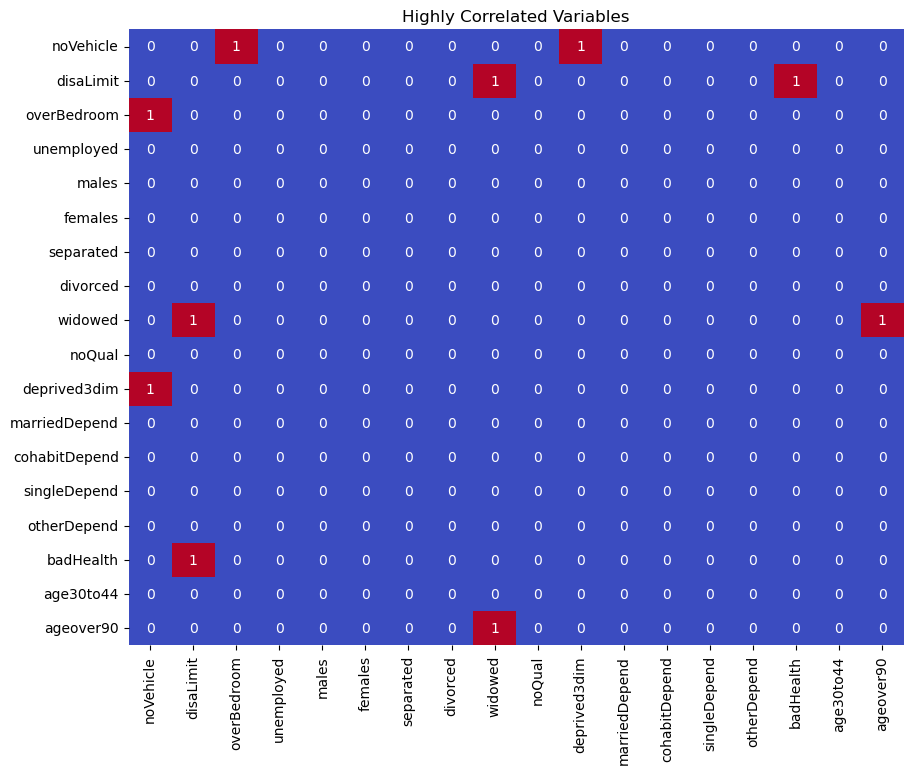

In [33]:
threshold = 0.7
# Started with a threshold of 80% - gives us disaLimit and bad health highly correlated
# Taking it down to 70%, we also have overBedroom and noVehicle, widowed and ageOver90, 
#      widowed and disaLimit, and noVehicle and deprived3dim

highly_correlated = (corr.abs() > threshold) & (corr.abs() < 1.0)

plt.figure(figsize=(10, 8))
sns.heatmap(highly_correlated, cmap='coolwarm', cbar=False, annot=True)

plt.title('Highly Correlated Variables')
plt.show()

The results of this multicolinearity analysis (set with a threshold for significance at 70%) allows us to conclude that the three most highly colerlated variables are 'widowed', 'noVehicle', and 'disaLimit'. Therefore, we will drop these three variables from our analysis.

In [34]:
# dropping the three most highly correlated variables from the dataframe
york_z_scores.drop(['widowed', 'noVehicle', 'disaLimit'], axis=1, inplace=True)
york_z_scores.info() # checking they've been dropped - yep all looking good

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 637 entries, 0 to 636
Data columns (total 15 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   overBedroom    637 non-null    float64
 1   unemployed     637 non-null    float64
 2   males          637 non-null    float64
 3   females        637 non-null    float64
 4   separated      637 non-null    float64
 5   divorced       637 non-null    float64
 6   noQual         637 non-null    float64
 7   deprived3dim   637 non-null    float64
 8   marriedDepend  637 non-null    float64
 9   cohabitDepend  637 non-null    float64
 10  singleDepend   637 non-null    float64
 11  otherDepend    637 non-null    float64
 12  badHealth      637 non-null    float64
 13  age30to44      637 non-null    float64
 14  ageover90      637 non-null    float64
dtypes: float64(15)
memory usage: 74.8 KB


In [35]:
# double checking the new matrix
corr_2 = york_z_scores.corr()
corr_2.style.background_gradient(cmap='coolwarm')

,overBedroom,unemployed,males,females,separated,divorced,noQual,deprived3dim,marriedDepend,cohabitDepend,singleDepend,otherDepend,badHealth,age30to44,ageover90
overBedroom,1.000000,0.582658,0.181342,-0.181342,0.300347,0.385286,0.213727,0.620930,-0.377975,0.306161,0.458175,0.214983,0.254857,0.200139,-0.094358
unemployed,0.582658,1.000000,0.032894,-0.032894,0.322925,0.433692,0.431757,0.689289,-0.295188,0.351115,0.542203,0.241959,0.394923,0.112552,0.030303
males,0.181342,0.032894,1.000000,-1.000000,0.035141,-0.127463,-0.257858,0.072022,-0.007578,-0.037837,-0.063209,-0.011039,-0.208747,0.186466,-0.319727
females,-0.181342,-0.032894,-1.000000,1.000000,-0.035141,0.127463,0.257858,-0.072022,0.007578,0.037837,0.063209,0.011039,0.208747,-0.186466,0.319727
separated,0.300347,0.322925,0.035141,-0.035141,1.000000,0.433243,0.194378,0.322901,-0.210241,0.282714,0.436310,0.115597,0.194163,0.377050,-0.086978
divorced,0.385286,0.433692,-0.127463,0.127463,0.433243,1.000000,0.461821,0.536044,-0.342173,0.280216,0.395863,-0.000403,0.462311,0.249680,0.082971
noQual,0.213727,0.431757,-0.257858,0.257858,0.194378,0.461821,1.000000,0.521622,-0.255562,0.223024,0.317447,0.140989,0.685093,-0.209298,0.316307
deprived3dim,0.620930,0.689289,0.072022,-0.072022,0.322901,0.536044,0.521622,1.000000,-0.420003,0.251954,0.452400,0.156329,0.566648,0.111622,0.041265
marriedDepend,-0.377975,-0.295188,-0.007578,0.007578,-0.210241,-0.342173,-0.255562,-0.420003,1.000000,0.092204,-0.103735,0.071924,-0.380255,0.131456,-0.117834
cohabitDepend,0.306161,0.351115,-0.037837,0.037837,0.282714,0.280216,0.223024,0.251954,0.092204,1.000000,0.545636,0.256489,0.012348,0.310302,-0.140894


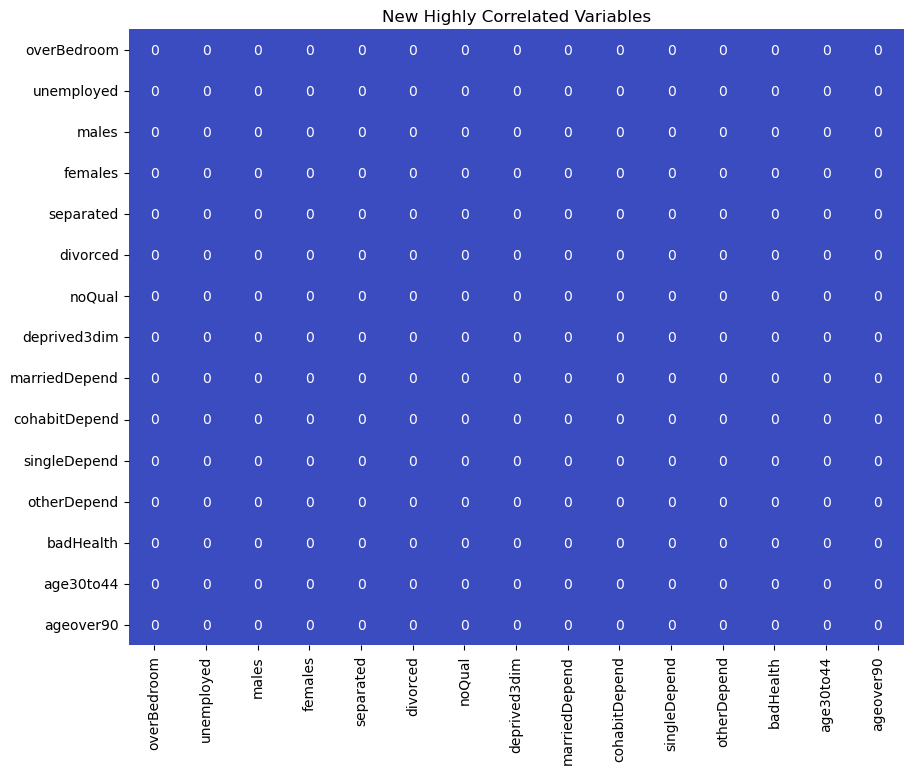

In [36]:
# checking again!
threshold = 0.7
highly_correlated_2 = (corr_2.abs() > threshold) & (corr_2.abs() < 1.0)

plt.figure(figsize=(10, 8))
sns.heatmap(highly_correlated_2, cmap='coolwarm', cbar=False, annot=True)

plt.title('New Highly Correlated Variables')
plt.show()

And success! We now have no highly correlated variables within our dataset. But now we've just got to the last bit of cleaning before we move on. We'll check for NaNs!

In [37]:
york_z_scores.isna().any().any() 
# this line returns False, and so we can conclude that we don't have any NaN variables!

False

## K-means clustering (tasks 7 to 11)
**7. Utilize the k-means clustering algorithm to create a classification based on the selected variables.**

**8. Define the optimum number of clusters (i.e., using the Elbow method). Experiment with different values of k.**

Now we have a lovely completed dataframe of z scores for uncorrelated variables, we can start using the k-mean clustering method to create clusters of similar populations. Firstly we need to define the optimum number of clusters for out analysis. We will do this using the elbow method

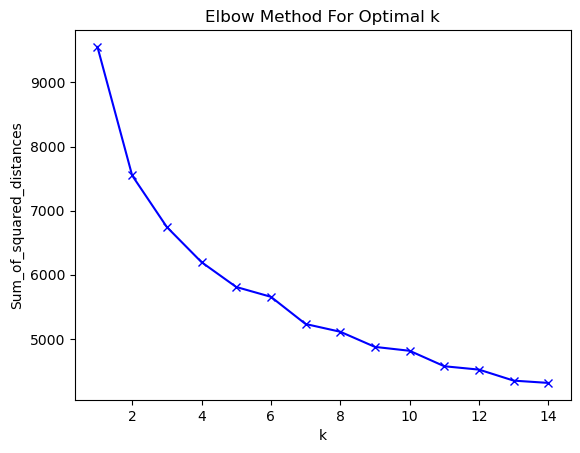

In [38]:
Sum_of_squared_distances = []

K_range = range(1,15) 

for k in K_range:
 km = KMeans(n_clusters=k)
 km = km.fit(york_z_scores)
 Sum_of_squared_distances.append(km.inertia_)
    
plt.plot(K_range, Sum_of_squared_distances, 'bx-')
plt.xlabel('k')
plt.ylabel('Sum_of_squared_distances')
plt.title('Elbow Method For Optimal k')
plt.show()

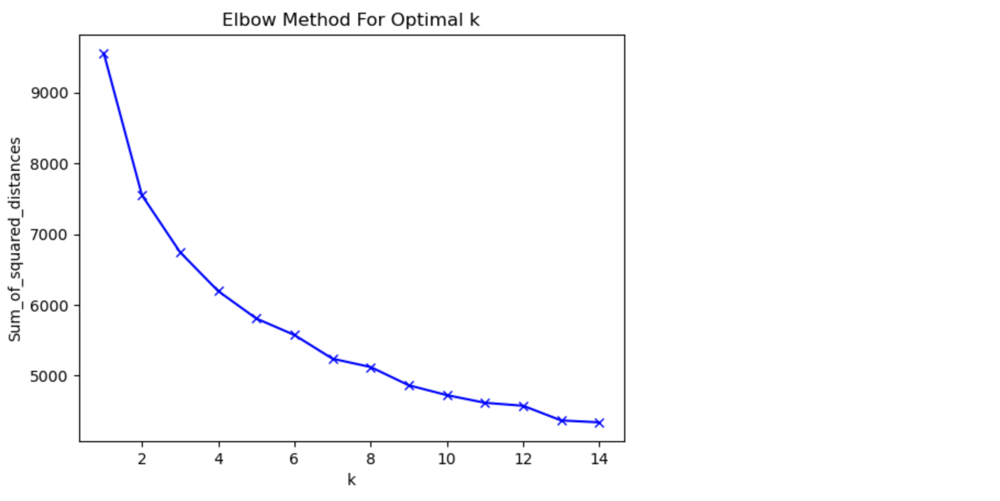

The above graph for measuring the optimal number of clusters prompts us to conclude that the optimal number of clusters for our analysis is 5, as after this, the line begins to plateau. The line steepens its drop between 6 and 7, but the sum of squared distances for 5 clusters when compared with 6 clusters is not dramatic enough to justify any more clusters than 5. 
However, we will also look at a graph summarising the between-cluster sum of squares to consolidate this.

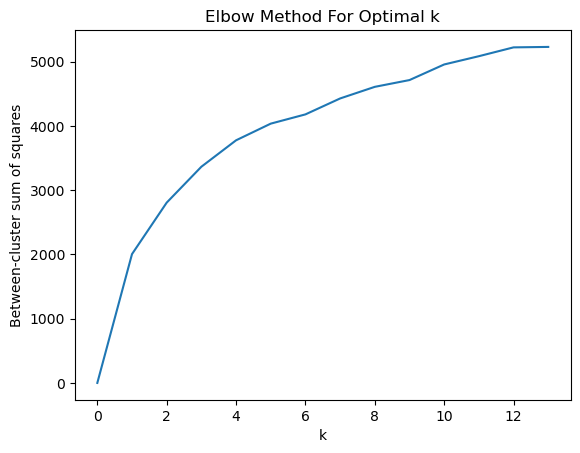

In [39]:
def elbow(dataframe, n):
    kMeansVar = [KMeans(n_clusters=k).fit(dataframe.values) for k in range(1, n)] #making use of list comprehensions.
    centroids = [X.cluster_centers_ for X in kMeansVar]
    k_euclid = [cdist(dataframe.values, cent) for cent in centroids]
    dist = [np.min(ke, axis=1) for ke in k_euclid]
    wcss = [sum(d**2) for d in dist]
    tss = sum(pdist(dataframe.values)**2)/dataframe.values.shape[0]
    bss = tss - wcss
    plt.plot(bss)
    plt.xlabel('k')
    plt.ylabel('Between-cluster sum of squares')
    plt.title('Elbow Method For Optimal k')
    plt.show()
 
elbow(york_z_scores,15)

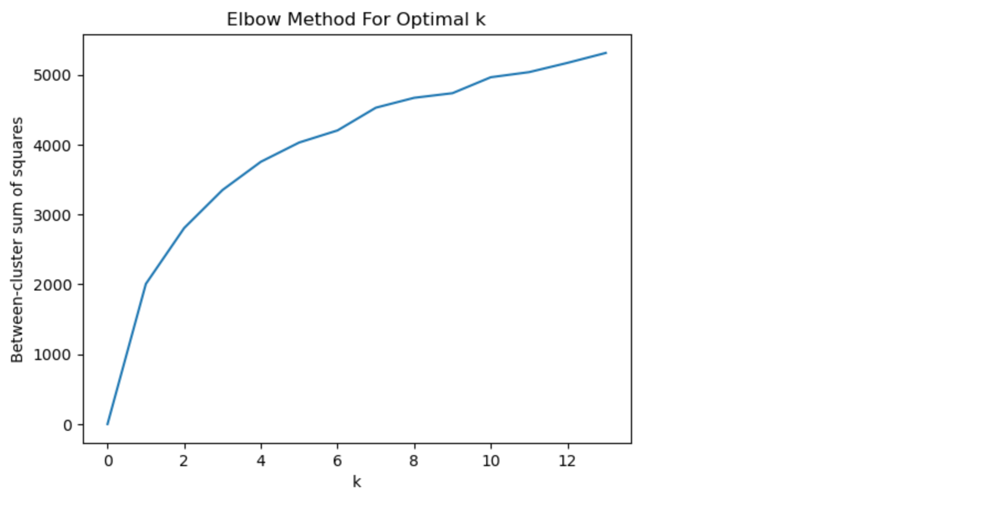
Analysis of between-cluster sum of squares reveals the same trend - a plataeuing of the trend when k exceeds 5. So we will continue our analysis with the aim of having 5 clusters.

In [40]:
# creating our cluster labels
kmeans = KMeans(n_clusters=6)
kmeans.fit(york_z_scores)
labels = kmeans.predict(york_z_scores)
cluster_centres = kmeans.cluster_centers_

york_z_scores['Cluster'] = kmeans.labels_

In [41]:
york_z_scores.head() # and our clusters are sitting beautifully there!

,overBedroom,unemployed,males,females,separated,divorced,noQual,deprived3dim,marriedDepend,cohabitDepend,singleDepend,otherDepend,badHealth,age30to44,ageover90,Cluster
0,1.113309,0.328331,-0.745631,0.745631,-1.155180,-0.305331,0.493902,1.261247,0.035995,0.787427,0.367343,2.627069,-0.461516,-0.872267,-0.456890,3
1,0.989181,1.493089,-0.467768,0.467768,1.594422,0.144767,0.962882,0.272256,-0.251726,2.473778,2.992954,1.041439,-0.253166,0.024159,-0.401654,3
2,0.970341,0.929367,0.175642,-0.175642,1.897438,2.040887,0.240452,1.279871,-0.475601,0.806040,1.768430,-0.066342,-0.298648,1.040963,-0.637449,3
3,1.229882,1.153117,0.543193,-0.543193,0.275698,0.981531,1.284903,1.323888,0.087876,1.216710,0.416093,0.343345,0.687849,0.643128,0.040926,3
4,-0.067667,-0.725464,-1.023378,1.023378,0.860141,0.814781,1.295945,0.282949,0.029461,0.456267,0.445114,3.460269,0.418916,0.146425,-0.240321,3


**9. Evaluate your cluster groups (e.g., using PCA) and interpret your cluster centres. Describe your results and repeat the process to adjust the variable selection and cluster groups to provide more meaningful results for your geodemographic goal. Interpret the characteristics of each cluster. What demographic patterns or similarities are prevalent within each group?**


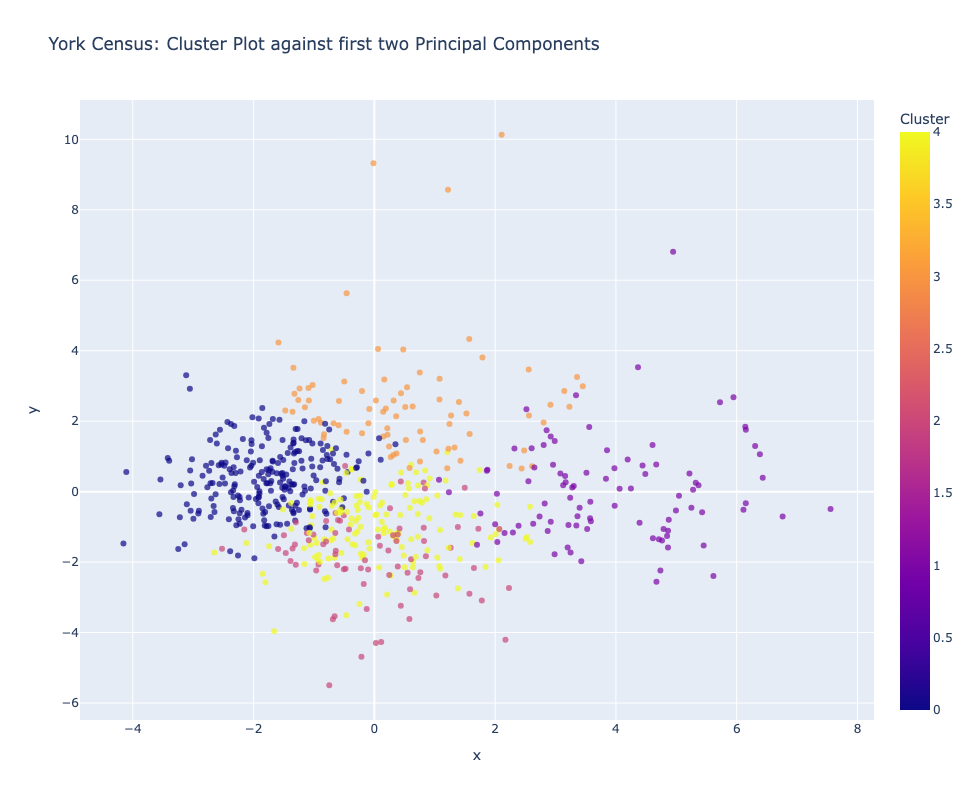

These two components explain 45.78% of the point variability.


<Figure size 1200x800 with 0 Axes>

In [42]:
plt.figure(figsize=(12, 8))

kmeans = KMeans(n_clusters=5)
clusters = kmeans.fit_predict(york_z_scores)

york_z_scores['Cluster'] = clusters

scaler = StandardScaler()
stand_data_scaled = scaler.fit_transform(york_z_scores)

# Carrying out the PCA analysis with these two lines of code
pca = PCA(n_components=2).fit(stand_data_scaled)
pca_result = pca.transform(stand_data_scaled)

#Percentage of variance explained by each of the selected components.
variance_ratio = pca.explained_variance_ratio_

# Create a scatter plot to show the results of this
fig = px.scatter(x=pca_result[:, 0], y=pca_result[:, 1], color=clusters,
                 labels={'color': 'Cluster'},
                 title='York Census: Cluster Plot against first two Principal Components',
                 opacity=0.7,
                 width=800, 
                 height=800)

plt.tight_layout()
fig.show()

print(f"These two components explain {(variance_ratio.sum()*100):.2f}% of the point variability.")


In [43]:
# interpreting the cluster centres

# Getting  cluster centers
#cluster_centers = kmeans.cluster_centers_
cluster_centers = pd.DataFrame(kmeans.cluster_centers_, columns=york_z_scores.columns)
cluster_centers.head(6)

,overBedroom,unemployed,males,females,separated,divorced,noQual,deprived3dim,marriedDepend,cohabitDepend,singleDepend,otherDepend,badHealth,age30to44,ageover90,Cluster
0,-0.643236,-0.467112,0.000883,-0.000883,-0.603579,-0.650500,-0.335920,-0.579952,0.491686,-0.411712,-0.590776,-0.025767,-0.370429,-0.524887,-0.110523,-2.220446e-15
1,1.291777,1.686071,-0.063869,0.063869,0.772582,1.093353,1.457928,1.738216,-0.521263,0.962368,1.430164,0.708116,1.140528,0.102278,0.026621,3.361702e+00
2,0.972681,0.140582,1.383793,-1.383793,0.212758,-0.091860,-0.832252,0.180148,-0.900808,-0.535122,-0.270374,-0.346255,-0.344795,0.428950,-0.354016,4.973684e+00
3,-0.242138,-0.320294,-1.146655,1.146655,0.064050,0.463062,0.794405,-0.009826,-0.604311,-0.400260,-0.409933,-0.590619,1.022439,-0.658029,1.223064,1.000000e+00
4,-0.160107,-0.220617,-0.050600,0.050600,0.321381,0.136948,-0.384566,-0.261117,0.329583,0.525772,0.386297,0.086642,-0.499200,0.889413,-0.313635,2.039735e+00


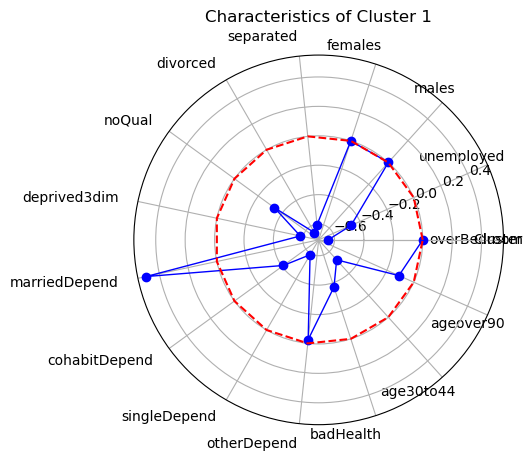

In [50]:
# LOOKING AT THE CHARACTERISTICS OF THE FIRST CLUSTER
first_row_centers = cluster_centers.iloc[0, :]

# saving the length of features
num_features = len(first_row_centers)

# getting the polar coordinates
theta = np.linspace(0, 2 * np.pi, num_features, endpoint=True)

fig, ax = plt.subplots(subplot_kw={'projection': 'polar'})
 # plots the centres
ax.plot(theta, first_row_centers, linewidth=1, color='blue', marker='o', label='Centers')

 # adding the red line into the plot where the value is 0.0
ax.plot(theta, np.zeros_like(first_row_centers), color='red', linestyle='--', label='Avarage')

ax.set_xticks(theta)
ax.set_xticklabels(cluster_centers.columns, rotation=45, ha='right')
plt.title("Characteristics of Cluster 1")
plt.show()

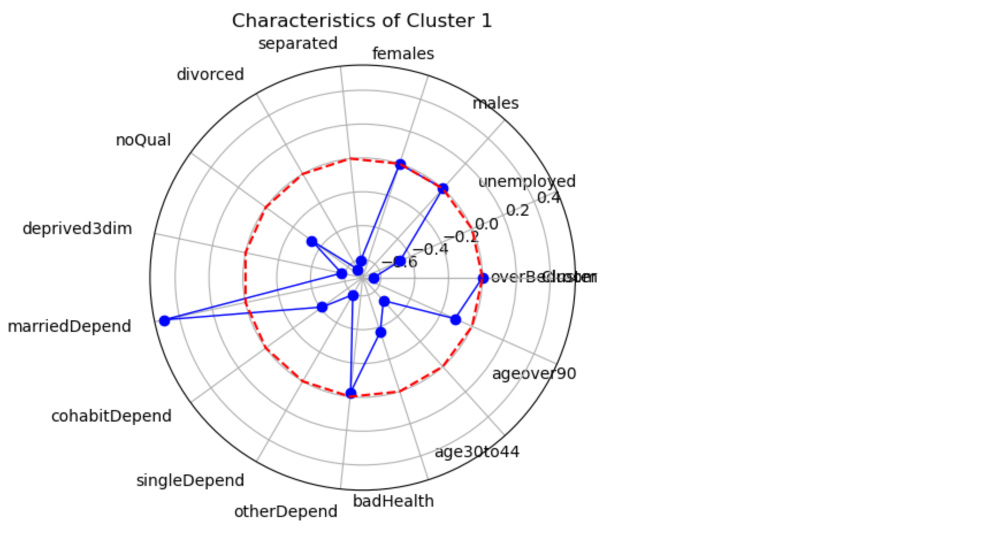
This plot shows the characteristics making up the our first cluster! This appears to include households with a married couple with dependent children, who are not deprived in 3 or more dimensions, not reporting bad heath, not age 30 to 44, and with formal qualifications. Now we have this, we can move onto looking at our second cluster.

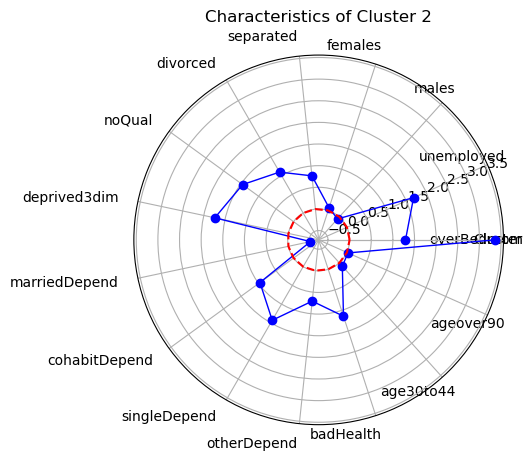

In [52]:
# THE SECOND CLUSTER
second_row_centers = cluster_centers.iloc[1, :]
num_features2 = len(second_row_centers)

theta2 = np.linspace(0, 2 * np.pi, num_features2, endpoint=True)

fig, ax = plt.subplots(subplot_kw={'projection': 'polar'})
ax.plot(theta2, second_row_centers, linewidth=1, color='blue', marker='o', label='Centers')

ax.plot(theta2, np.zeros_like(second_row_centers), color='red', linestyle='--', label='Avarage')

ax.set_xticks(theta2)
ax.set_xticklabels(cluster_centers.columns, rotation=45, ha='right')
plt.title("Characteristics of Cluster 2")
plt.show()

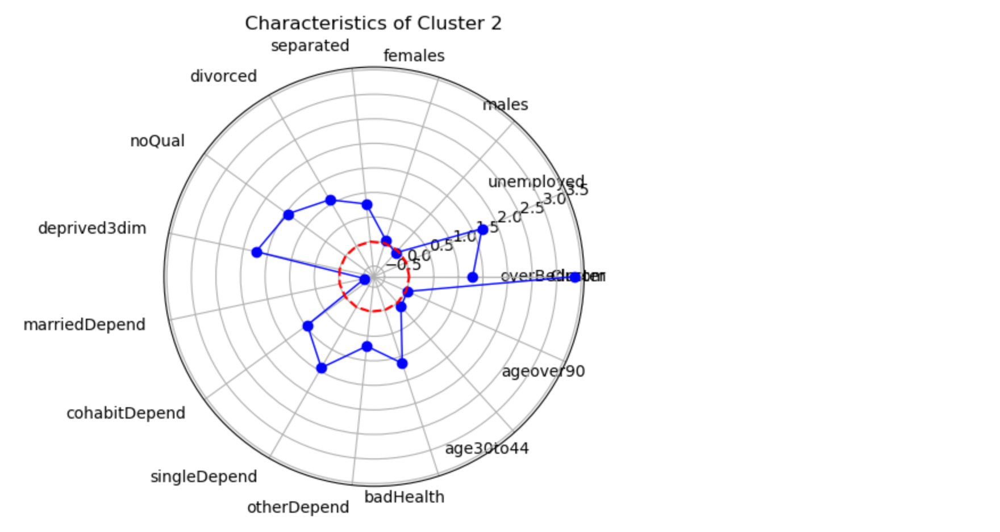
This description of the second cluster appears to be an inverse of the first. It focuses more on unmarried or single households with depended children, with reported bad health and overcrowding. There's an increase in people who are divorced, separated, and without any formal qualifications, alongside households that are defined as deprived in 3 or more dimesions. The main defining feature can be observed to be overcrowding.

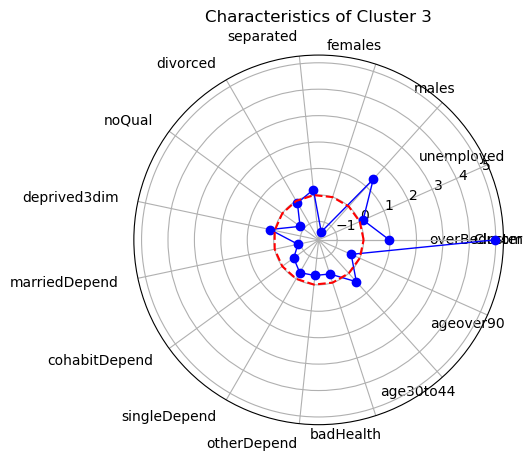

In [53]:
# THE THIRD CLUSTER
third_row_centers = cluster_centers.iloc[2, :]
num_features3 = len(third_row_centers)

theta3 = np.linspace(0, 2 * np.pi, num_features3, endpoint=True)
fig, ax = plt.subplots(subplot_kw={'projection': 'polar'})
ax.plot(theta3, third_row_centers, linewidth=1, color='blue', marker='o', label='Centers')
ax.plot(theta3, np.zeros_like(third_row_centers), color='red', linestyle='--', label='Avarage')
ax.set_xticks(theta3)
ax.set_xticklabels(cluster_centers.columns, rotation=45, ha='right')
plt.title("Characteristics of Cluster 3")
plt.show()

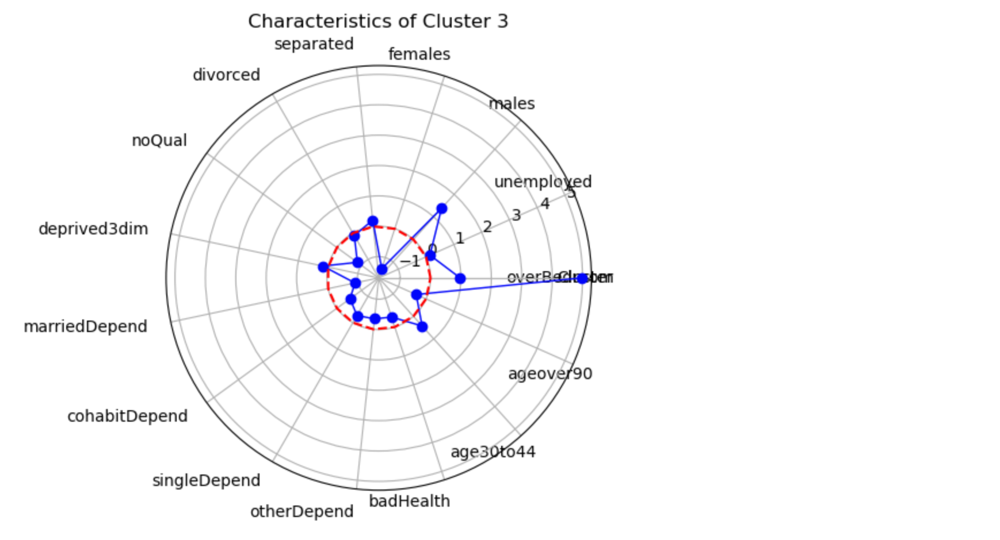
Cluster 3 can mostly be defined by men and overcrowding. There's a slightly increase that would also determine that it's typically males aged 30 to 44 in households that can be defined as deprived in 3 or more dimensions.

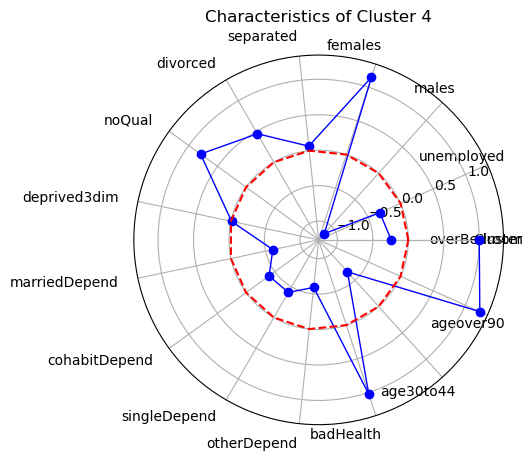

In [54]:
# THE FORTH CLUSTER
forth_row_centers = cluster_centers.iloc[3, :]
num_features4 = len(forth_row_centers)

theta4 = np.linspace(0, 2 * np.pi, num_features4, endpoint=True)
fig, ax = plt.subplots(subplot_kw={'projection': 'polar'})
ax.plot(theta4, forth_row_centers, linewidth=1, color='blue', marker='o', label='Centers')
ax.plot(theta4, np.zeros_like(forth_row_centers), color='red', linestyle='--', label='Avarage')
ax.set_xticks(theta4)
ax.set_xticklabels(cluster_centers.columns, rotation=45, ha='right')
plt.title("Characteristics of Cluster 4")
plt.show()

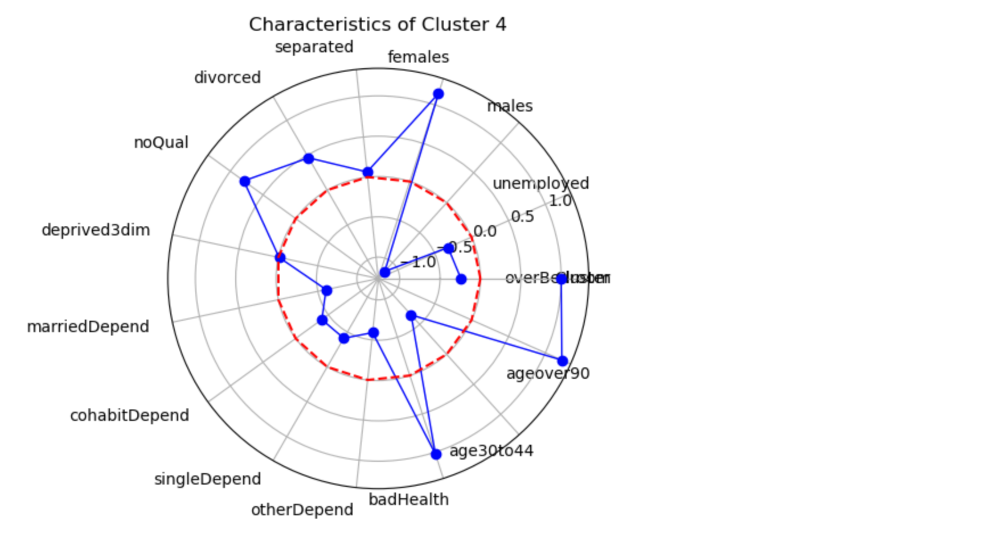
The counterpart to cluster 3, cluster 4 includes women without any dependents, divorced or separated, and without qualifications

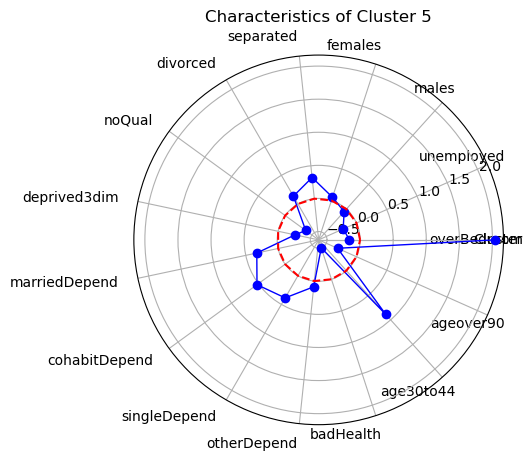

In [55]:
# THE FIFTH CLUSTER
fifth_row_centers = cluster_centers.iloc[4, :]
num_features5 = len(fifth_row_centers)

theta5 = np.linspace(0, 2 * np.pi, num_features5, endpoint=True)
fig, ax = plt.subplots(subplot_kw={'projection': 'polar'})
ax.plot(theta5, fifth_row_centers, linewidth=1, color='blue', marker='o', label='Centers')
ax.plot(theta5, np.zeros_like(fifth_row_centers), color='red', linestyle='--', label='Avarage')
ax.set_xticks(theta5)
ax.set_xticklabels(cluster_centers.columns, rotation=45, ha='right')
plt.title("Characteristics of Cluster 5")
plt.show()

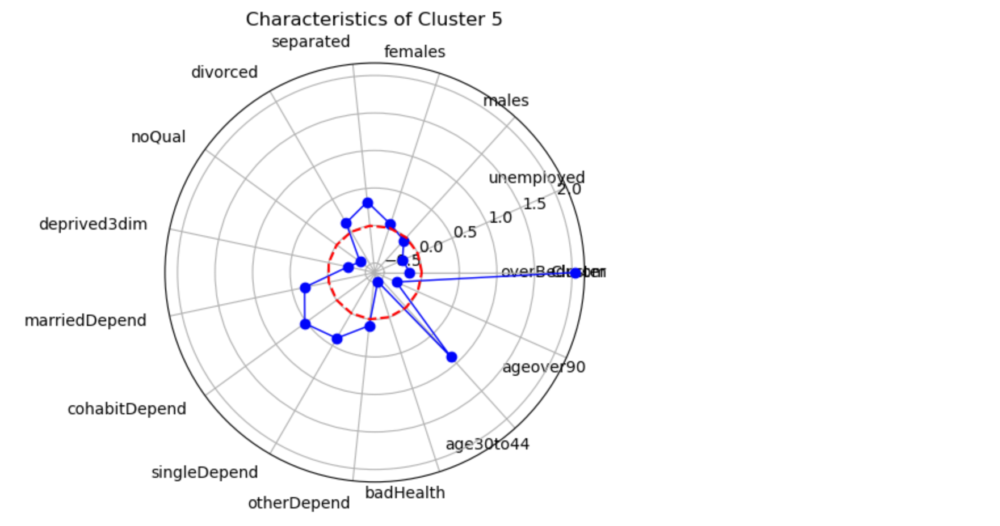
The final cluster appears to group households with dependants, and individuals between the ages of 30 and 44 experiences overcrowding in their homes.

**10. Map the final cluster groups**

To map the final clusters, we need to first get rid of our standardised percentages and return our original values. To do this we drop all of the values from our york_z_score dataframe, and then concatonate the cluster numbers left in the york_z_score dataframe with our original york_census_data dateframe to form our final dataframe!

In [57]:
list(york_z_scores.columns) # listing the columns to see what we need to drop!

['overBedroom',
 'unemployed',
 'males',
 'females',
 'separated',
 'divorced',
 'noQual',
 'deprived3dim',
 'marriedDepend',
 'cohabitDepend',
 'singleDepend',
 'otherDepend',
 'badHealth',
 'age30to44',
 'ageover90',
 'Cluster']

In [58]:
york_z_scores.drop([
 'overBedroom',
 'unemployed',
 'males',
 'females',
 'separated',
 'divorced',
 'noQual',
 'deprived3dim',
 'marriedDepend',
 'cohabitDepend',
 'singleDepend',
 'otherDepend',
 'badHealth',
 'age30to44',
 'ageover90'
], axis=1, inplace=True)

york_z_scores.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 637 entries, 0 to 636
Data columns (total 1 columns):
 #   Column   Non-Null Count  Dtype
---  ------   --------------  -----
 0   Cluster  637 non-null    int32
dtypes: int32(1)
memory usage: 2.6 KB


In [60]:
final_york_df = pd.concat([york_census_data, york_z_scores], axis=1, ignore_index=False)
final_york_df.head()

,oa_code,geometry,noVehicle,disaLimit,overBedroom,unemployed,males,females,separated,divorced,...,noQual,deprived3dim,marriedDepend,cohabitDepend,singleDepend,otherDepend,badHealth,age30to44,ageover90,Cluster
0,E00067637,"POLYGON ((462922.418 451627.087, 462923.413 45...",43.089431,5.289673,12.195122,5.524862,46.095718,53.904282,0.625000,7.812500,...,23.437500,7.317073,14.634146,5.691057,7.317073,5.691057,3.022670,14.861461,0.251889,1
1,E00067657,"POLYGON ((462138.199 451643.374, 462150.138 45...",41.322314,5.263158,11.570248,9.352518,47.039474,52.960526,4.035874,9.417040,...,27.802691,4.132231,12.396694,9.917355,18.181818,3.305785,3.618421,20.065789,0.328947,1
2,E00067859,"POLYGON ((457422.000 449898.000, 457424.784 44...",32.786885,6.589147,11.475410,7.500000,49.224806,50.775194,4.411765,16.176471,...,21.078431,7.377049,10.655738,5.737705,13.114754,1.639344,3.488372,25.968992,0.000000,1
3,E00067868,"POLYGON ((456586.580 450678.969, 456586.981 45...",35.338346,6.940063,12.781955,8.235294,50.473186,49.526814,2.400000,12.400000,...,30.800000,7.518797,15.037594,6.766917,7.518797,2.255639,6.309148,23.659306,0.946372,1
4,E00067873,"POLYGON ((456712.569 450655.748, 456709.691 45...",33.333333,8.310249,6.250000,2.061856,45.152355,54.847645,3.125000,11.805556,...,30.902778,4.166667,14.583333,4.861111,7.638889,6.944444,5.540166,20.775623,0.554017,4


In [61]:
final_york_df.columns # clusters at the end there looking lovely

Index(['oa_code', 'geometry', 'noVehicle', 'disaLimit', 'overBedroom',
       'unemployed', 'males', 'females', 'separated', 'divorced', 'widowed',
       'noQual', 'deprived3dim', 'marriedDepend', 'cohabitDepend',
       'singleDepend', 'otherDepend', 'badHealth', 'age30to44', 'ageover90',
       'Cluster'],
      dtype='object')

In [62]:
# and lets have a look at our final map!
final_york_df.explore(column='Cluster', cmap='Set1', tiles='CartoDB positron')

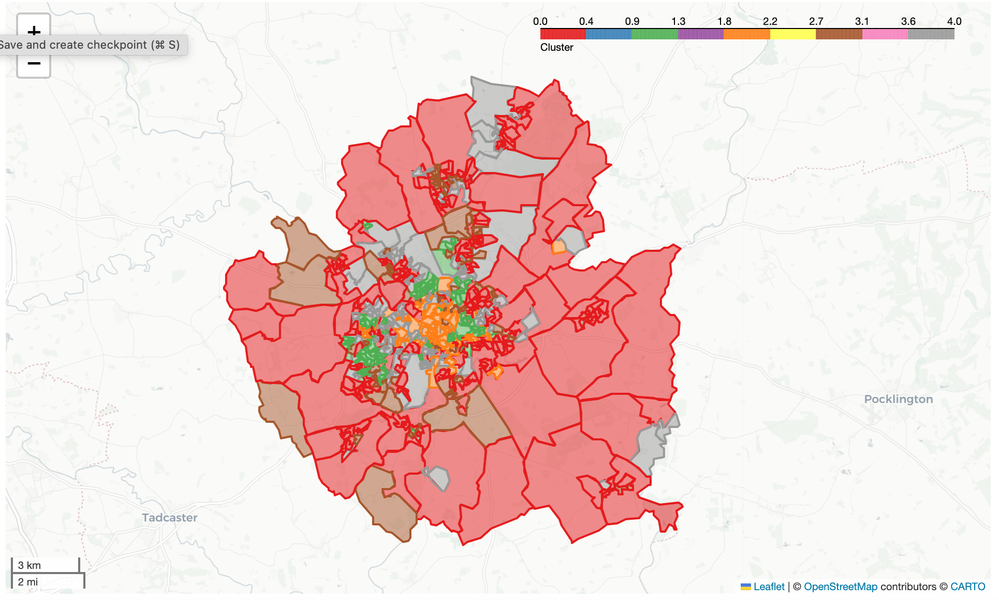
The first cluster looks to be the largest. Let's just have a look at how many areas there are in each cluster to double check

**11. Finish the analysis by naming the final clusters and plotting a final map that includes the census values and the provided names.**


In [ ]:
# renaming the columns
def rename_column(x):
    x = x.replace("0", "Married household: with dependents")
    x = x.replace("1",
    x = x.replace("2", "Overcrowding: no dependednts")
    x = x.replace("3", "Women: no dependants")
    x = x.replace("4", "Overcrowding: with dependents")

**12. Finally, acknowledge the subjective nature of classification and make analytical decisions to produce an optimum classification for your specific purpose. Reflect on the challenges and insights gained during the classification process. Ensure you document your analytical decisions and the rationale behind any important decision. Once your geodemographics are constructed, describe the potential use cases for the geodemographic classification you have built based on your initial goal.**

---

## References:

- UK Data Service (2011) *Infuse*. Available at: http://infuse.ukdataservice.ac.uk/. (Accessed on: 9th March 2024).
- UK Data Service (2024) *Boundary Data Selector*. Available at: https://borders.ukdataservice.ac.uk/bds.html. (Accessed on: 10th March 2024).